In [187]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import folium
from folium.plugins import MarkerCluster

In [188]:
# Load the dataset

df = pd.read_csv('data/listings.csv')

In [189]:
## replace $ symbol from price column

df['price'] = df.price.replace({'\$':''}, regex = True)
df['price'] = df['price'].replace({'\,':''}, regex = True)
df['price'] = df['price'].astype(float)

Text(0, 0.5, 'Listings')

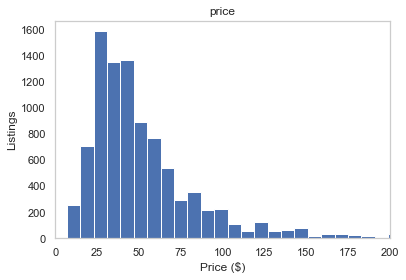

In [190]:
# Plot price distribution

fig, ax = plt.subplots()
df.hist(column='price',grid=False,bins = 1000,ax = ax)
ax.set_xlim(0,200)
plt.xlabel('Price ($)')
plt.ylabel('Listings')


Superhosts

### Interactive map of Listings

In [5]:
def generate_color(price):
    if price <= 43:
        c_outline, c_fill = 'green', 'green'
        #m_opacity, f_opacity = 0.4, 0.4
    else:
        c_outline, c_fill = 'red', 'red'
        #m_opacity, f_opacity = 0.4, 0.4
    return c_outline, c_fill #, m_opacity, f_opacity

def generate_popup(bedrooms,baths,rating,neighbourhood_cleansed, review_scores_location):
    return f'''<strong>Bedrooms:</strong>{bedrooms}
                <strong>Baths:</strong>{baths}
                <strong>Listing Rating:</strong>{rating}
            <strong>Neighbourhood:</strong>{neighbourhood_cleansed}
            <br><strong>Location Review:</strong>{review_scores_location}'''


map1 = folium.Map(location=[37.9819, 23.7336], zoom_start=13)
marker_cluster = MarkerCluster().add_to(map1)
for _, row in df.iterrows():
    c_outline, c_fill = generate_color(row['price'])
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        popup=generate_popup(row['bedrooms'],row['bathrooms_text'],row['review_scores_rating'] ,row['neighbourhood_cleansed'], row['review_scores_location']),
        color=c_outline,
        fill=True,
        fillColor=c_fill,
        radius = (3),
        opacity=0.4,
        fillOpacity=0.4
    ).add_to(map1)
map1


In [210]:
# Load the clean dataset (symbols removed and imputed)
df2 = pd.read_csv('listings_v2.csv')


df_hot=pd.get_dummies(df2[[ 'neighbourhood_cleansed']])
df = pd.concat([df2, df_hot], axis=1)
df.drop(['neighbourhood_cleansed'],axis=1,inplace=True)

# create a dataframe with neghbourhoods
neighbourhoods = df.iloc[:,-44:]
# create a dataframe with amenities
amenities = df2[['check_in_24h',
       'air_conditioning', 'high_end_electronics', 'bbq', 
       'nature_and_views', 'bed_linen', 'breakfast', 'tv', 'coffee_machine',
       'cooking_basics', 'white_goods', 'elevator', 'gym', 'child_friendly',
       'parking', 'outdoor_space', 'host_greeting', 'hot_tub_sauna_or_pool',
       'internet', 'long_term_stays', 'pets_allowed', 'private_entrance',
       'secure', 'self_check_in', 'smoking_allowed', 'accessible',
       'event_suitable', 'netflix', 'fireplace', 'cable_tv',
       'luggage_dropof_allowed']]

In [211]:
neighbourhoods.columns

Index(['neighbourhood_cleansed_1Ο ΝΕΚΡΟΤΑΦΕΙΟ',
       'neighbourhood_cleansed_ΑΓΙΟΣ ΕΛΕΥΘΕΡΙΟΣ',
       'neighbourhood_cleansed_ΑΓΙΟΣ ΚΩΝΣΤΑΝΤΙΝΟΣ-ΠΛΑΤΕΙΑ ΒΑΘΗΣ',
       'neighbourhood_cleansed_ΑΓΙΟΣ ΝΙΚΟΛΑΟΣ',
       'neighbourhood_cleansed_ΑΚΑΔΗΜΙΑ ΠΛΑΤΩΝΟΣ',
       'neighbourhood_cleansed_ΑΚΡΟΠΟΛΗ', 'neighbourhood_cleansed_ΑΜΠΕΛΟΚΗΠΟΙ',
       'neighbourhood_cleansed_ΑΝΩ ΚΥΨΕΛΗ',
       'neighbourhood_cleansed_ΑΝΩ ΠΑΤΗΣΙΑ',
       'neighbourhood_cleansed_ΒΟΤΑΝΙΚΟΣ', 'neighbourhood_cleansed_ΓΚΑΖΙ',
       'neighbourhood_cleansed_ΓΚΥΖΗ', 'neighbourhood_cleansed_ΓΟΥΒΑ',
       'neighbourhood_cleansed_ΓΟΥΔΙ', 'neighbourhood_cleansed_ΕΛΛΗΝΟΡΩΣΩΝ',
       'neighbourhood_cleansed_ΕΜΠΟΡΙΚΟ ΤΡΙΓΩΝΟ-ΠΛΑΚΑ',
       'neighbourhood_cleansed_ΖΑΠΠΕΙΟ', 'neighbourhood_cleansed_ΘΗΣΕΙΟ',
       'neighbourhood_cleansed_ΙΛΙΣΙΑ', 'neighbourhood_cleansed_ΚΕΡΑΜΕΙΚΟΣ',
       'neighbourhood_cleansed_ΚΟΛΟΚΥΝΘΟΥ', 'neighbourhood_cleansed_ΚΟΛΩΝΑΚΙ',
       'neighbourhood_cleansed_ΚΟΛΩΝΟΣ',
       'neighbourh

In [200]:
# Function to plot categories count and median price

def binary_count_and_price_plot(col, df_category, df_price, figsize=(8,3)):
   
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(top=0.80) 
    
    df_category.groupby(col).size().plot(kind='bar', ax=ax1, color=['orange', 'seagreen'])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')
    
    df_price.groupby(col).price.median().plot(kind='bar', ax=ax2, color=['orange', 'seagreen'])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price ($)')
    ax2.set_xlabel('')
    
    plt.show()

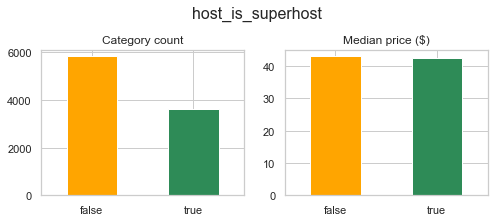

f    0.615816
t    0.384184
Name: host_is_superhost, dtype: float64


In [201]:
binary_count_and_price_plot('host_is_superhost', df, df)
print(df.host_is_superhost.value_counts(normalize=True))

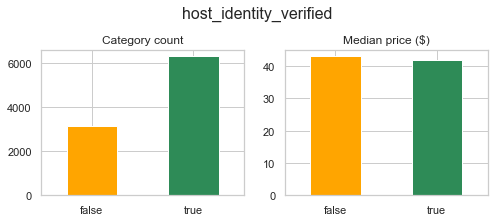

t    0.66635
f    0.33365
Name: host_identity_verified, dtype: float64

In [194]:
binary_count_and_price_plot('host_identity_verified', df, df)
df.host_identity_verified.value_counts(normalize=True)

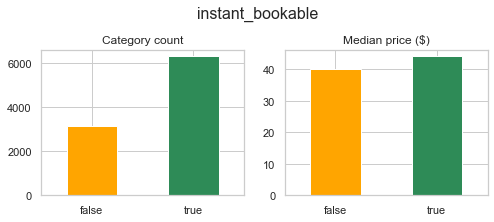

t    0.666843
f    0.333157
Name: instant_bookable, dtype: float64


In [195]:
binary_count_and_price_plot('instant_bookable', df, df)
print(df.instant_bookable.value_counts(normalize=True))

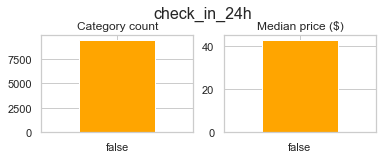

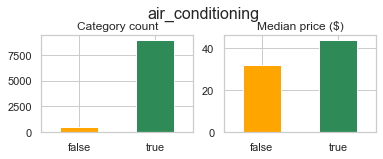

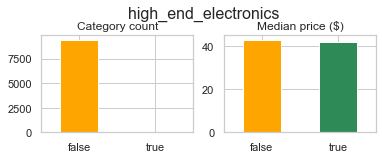

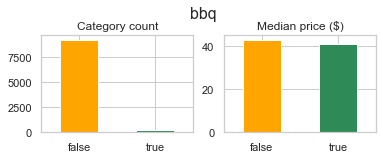

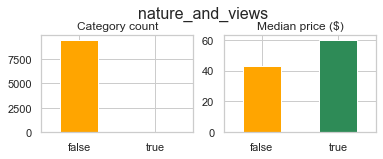

...

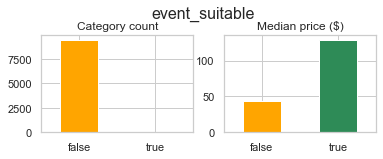

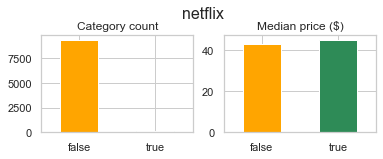

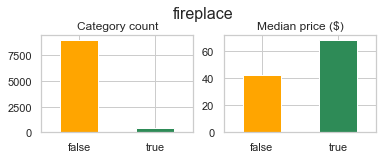

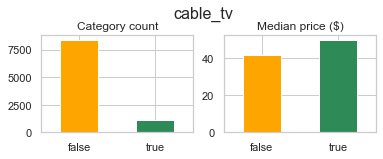

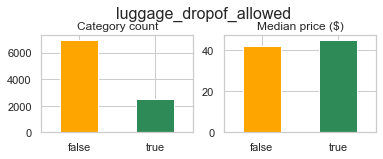

In [202]:
for col in amenities:
    binary_count_and_price_plot(col, amenities, df2, figsize=(6,2))

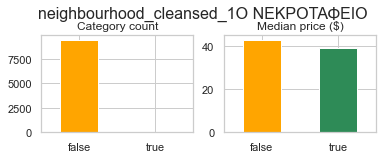

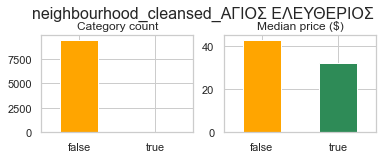

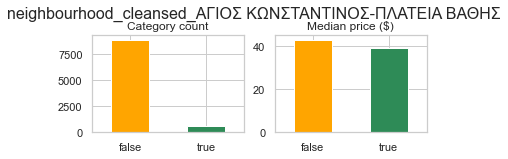

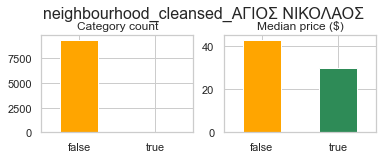

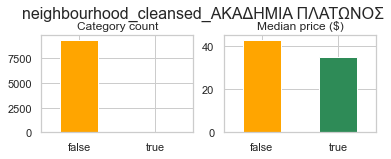

...

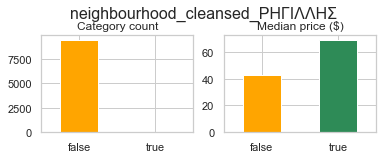

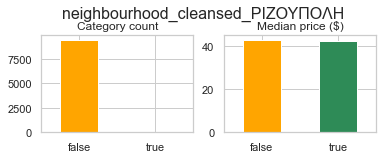

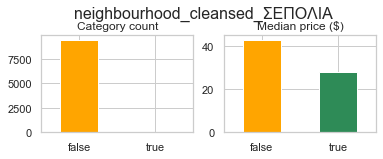

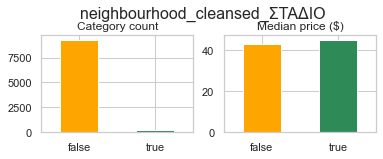

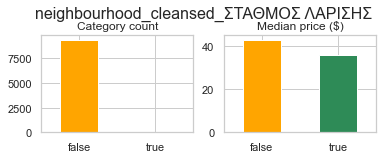

In [213]:
for col in neighbourhoods:
    binary_count_and_price_plot(col,neighbourhoods, df, figsize=(6,2))

In [231]:
# Apply filters to the dataset

sns.set_theme(style="whitegrid")
df = df.drop(df[df.price > 150].index)
df.drop(df[df.bedrooms > 6].index, inplace=True)
df.drop(df[df.minimum_nights > 200].index, inplace=True)
df.drop(df[df.number_of_reviews > 600].index, inplace=True)
df.drop(df[df.maximum_nights > 1200].index, inplace=True)
df.drop(df[df.number_of_baths > 5].index, inplace=True)
df.drop(df[df.reviews_per_month > 11].index, inplace=True)
df.drop(df[df.beds > 14].index, inplace=True)

In [121]:
#### Create boxplots (feature - price) for outlier detection

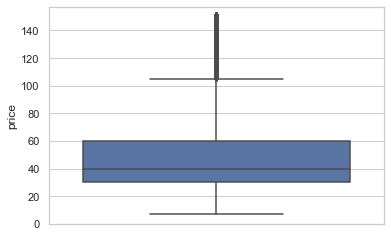

In [218]:
# Price
ax = sns.boxplot(y="price", data=df)

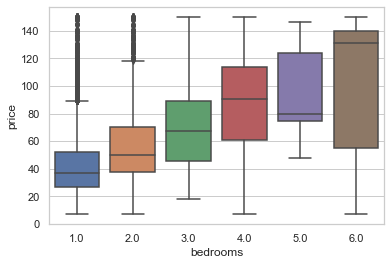

In [219]:
# Bedrooms
ax = sns.boxplot(x="bedrooms", y="price", data=df)

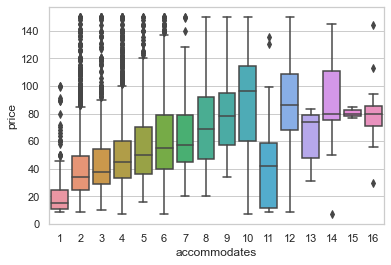

In [220]:
# Accomodates
ax = sns.boxplot(x="accommodates", y="price", data=df)

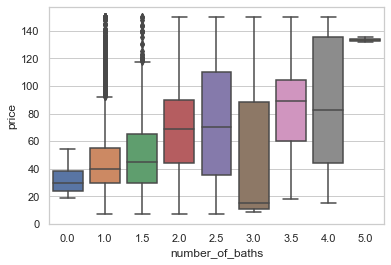

In [221]:
# Number of baths
ax = sns.boxplot(x="number_of_baths", y="price", data=df)

In [ ]:
#### Correlation Heatmaps

In [222]:
# Split the dataframe for better visualization
df_EDA = df[['host_response_rate','host_acceptance_rate','accommodates','bedrooms','beds','minimum_nights',	'maximum_nights','number_of_reviews','review_scores_rating','review_scores_accuracy','review_scores_cleanliness'	,'review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value','reviews_per_month','number_of_baths','price']].copy()

df_EDA2 = df_EDA[['host_response_rate','host_acceptance_rate','accommodates','bedrooms','minimum_nights',	'maximum_nights','number_of_reviews','review_scores_rating','number_of_baths','price']].copy()

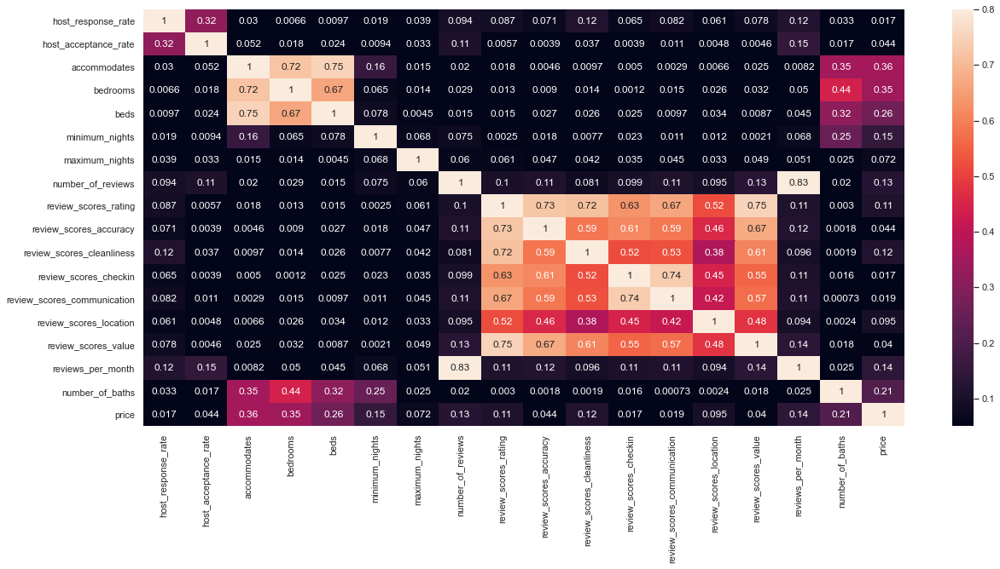

In [225]:
corr_matrix = df_EDA.corr()
corr_matrix = abs(corr_matrix)
f, ax = plt.subplots(figsize=(20, 9))
sns.heatmap(corr_matrix, vmax=0.8, vmin=0.05, annot=True)

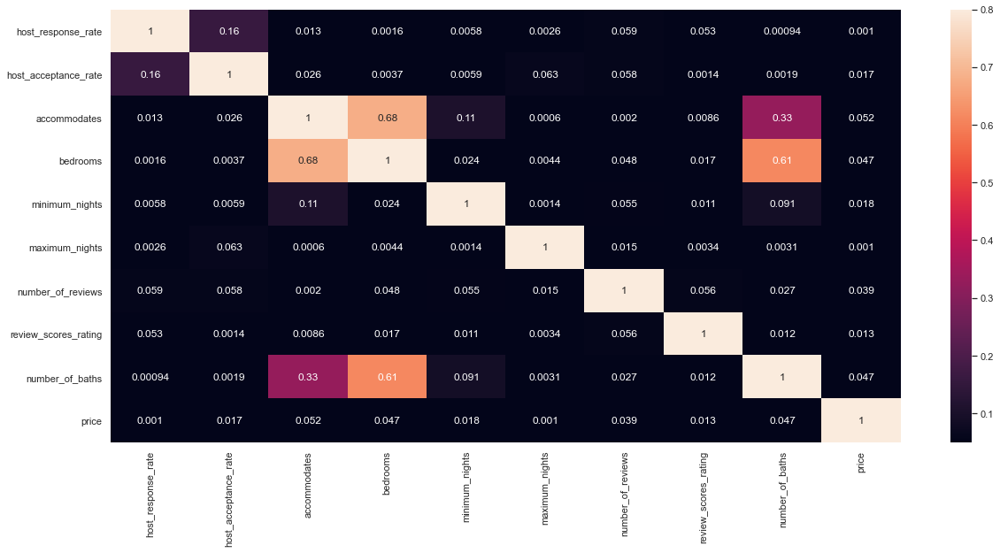

In [124]:
corr_matrix = df_EDA2.corr()
corr_matrix = abs(corr_matrix)
f, ax = plt.subplots(figsize=(20, 9))
sns.heatmap(corr_matrix, vmax=0.8, vmin=0.05, annot=True)